<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#1.-MVC-project-description" data-toc-modified-id="1.-MVC-project-description-1">1. MVC project description</a></span></li><li><span><a href="#2.-Setup" data-toc-modified-id="2.-Setup-2">2. Setup</a></span></li><li><span><a href="#3.-Load-the-data" data-toc-modified-id="3.-Load-the-data-3">3. Load the data</a></span></li><li><span><a href="#4.-Explore-the-data" data-toc-modified-id="4.-Explore-the-data-4">4. Explore the data</a></span><ul class="toc-item"><li><span><a href="#4.1.-Muscles-by-dataset" data-toc-modified-id="4.1.-Muscles-by-dataset-4.1">4.1. Muscles by dataset</a></span></li><li><span><a href="#4.2.-Tests-by-dataset" data-toc-modified-id="4.2.-Tests-by-dataset-4.2">4.2. Tests by dataset</a></span></li><li><span><a href="#4.3.-Muscles-and-tests-count" data-toc-modified-id="4.3.-Muscles-and-tests-count-4.3">4.3. Muscles and tests count</a></span></li><li><span><a href="#4.4.-Which-test-normalizes-which-muscle" data-toc-modified-id="4.4.-Which-test-normalizes-which-muscle-4.4">4.4. Which test normalizes which muscle</a></span></li></ul></li><li><span><a href="#5.-Tests-selection" data-toc-modified-id="5.-Tests-selection-5">5. Tests selection</a></span><ul class="toc-item"><li><span><a href="#5.1.-Plot-the-missing-values" data-toc-modified-id="5.1.-Plot-the-missing-values-5.1">5.1. Plot the missing values</a></span></li><li><span><a href="#5.2.-Display-positions" data-toc-modified-id="5.2.-Display-positions-5.2">5.2. Display positions</a></span></li></ul></li></ul></div>

# 1. MVC project description

**Links**
- [github repo](https://github.com/romainmartinez/mvc)
- [plotly figures](https://plot.ly/organize/romainmartinez:114)

**Author**: _Romain Martinez._

# 2. Setup

In [1]:
# Common imports
import pandas as pd
# import numpy as np
import scipy.io as sio

# custom functions
import mvc
%load_ext autoreload
%autoreload 2

# Path
from pathlib import Path
PROJECT_PATH = Path('./')
DATA_PATH = PROJECT_PATH / 'data'
MODEL_PATH = PROJECT_PATH / 'model'

# Figures
OFFLINE = True
if OFFLINE:
    import plotly.offline as py
    py.init_notebook_mode(connected=True)
else:
    import plotly.plotly as py
    
import dill as pickle

# 3. Load the data

In [3]:
df_tidy = pd.read_feather(DATA_PATH / 'df_tidy')
# df_tidy_normalized = pd.read_feather(DATA_PATH / 'df_tidy_normalized')
df_wide = pd.read_feather(DATA_PATH / 'df_wide')

with open(MODEL_PATH / 'conf.pkl', 'rb') as h:
    conf = pickle.load(h)

EOFError: Ran out of input

# 4. Explore the data

## 4.1. Muscles by dataset

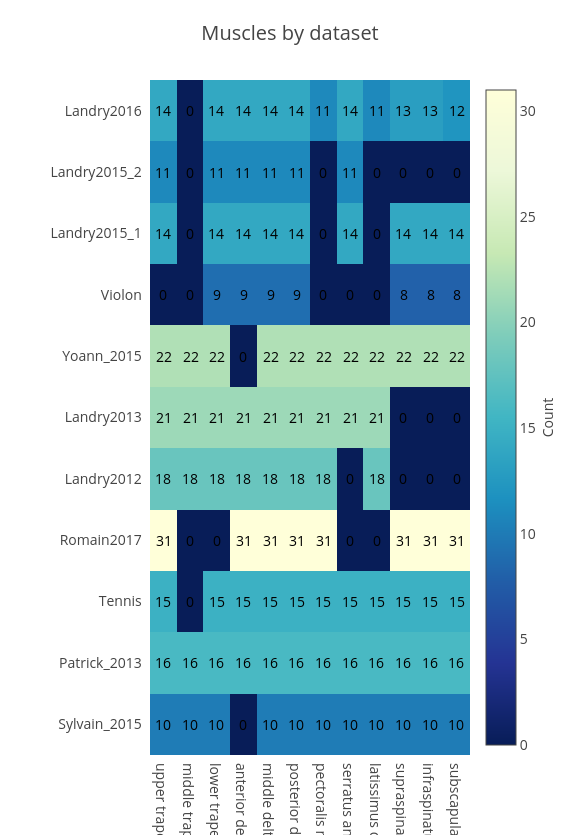

In [3]:
muscle_by_dataset = mvc.plot.count_by_dataset(
    df_tidy,
    values='test',
    index='dataset',
    columns='muscle',
    ylabel=conf['DATASETS'],
    xlabel=conf['MUSCLES'],
    title='Muscles by dataset')
py.iplot(muscle_by_dataset, filename='mvc/muscles_by_dataset')

## 4.2. Tests by dataset

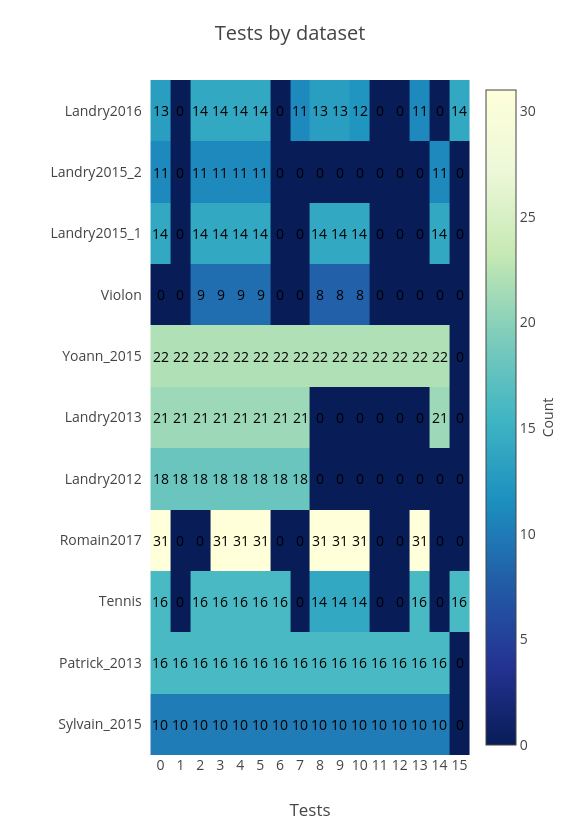

In [4]:
muscle_by_dataset = mvc.plot.count_by_dataset(
    df_tidy,
    values='muscle',
    index='dataset',
    columns='test',
    ylabel=conf['DATASETS'],
    xtitle='Tests',
    title='Tests by dataset')
py.iplot(muscle_by_dataset, filename='mvc/tests_by_dataset')

## 4.3. Muscles and tests count

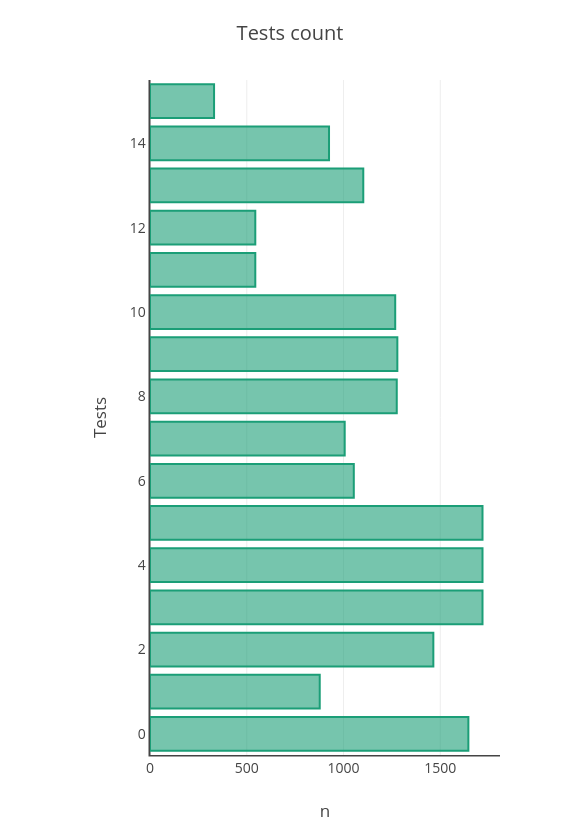

In [5]:
test_count_bar = mvc.plot.count_bar(
    df_tidy, 'test', title='Tests count', xtitle='n', ytitle='Tests')
py.iplot(test_count_bar, filename='mvc/test_count_bar')

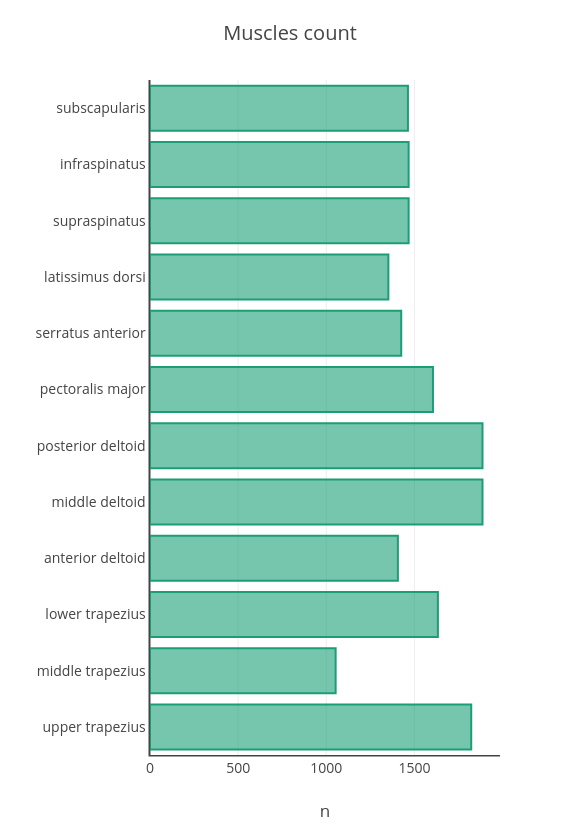

In [6]:
muscle_count_bar = mvc.plot.count_bar(
    df_tidy, 'muscle', ylabel=conf['MUSCLES'], title='Muscles count', xtitle='n')
py.iplot(muscle_count_bar, filename='mvc/muscle_count_bar')

## 4.4. Which test normalizes which muscle

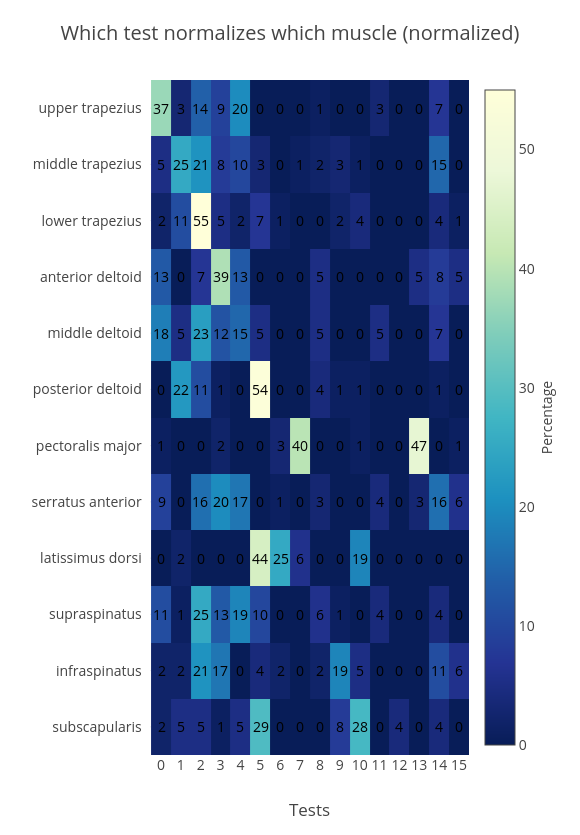

In [7]:
max_by_test = mvc.plot.max_by_test(
    df_tidy_normalized,
    ylabel=conf['MUSCLES'],
    xtitle='Tests',
    title='Which test normalizes which muscle (normalized)')

py.iplot(max_by_test, filename='mvc/max_by_test')

# 5. Tests selection

## 5.1. Plot the missing values 

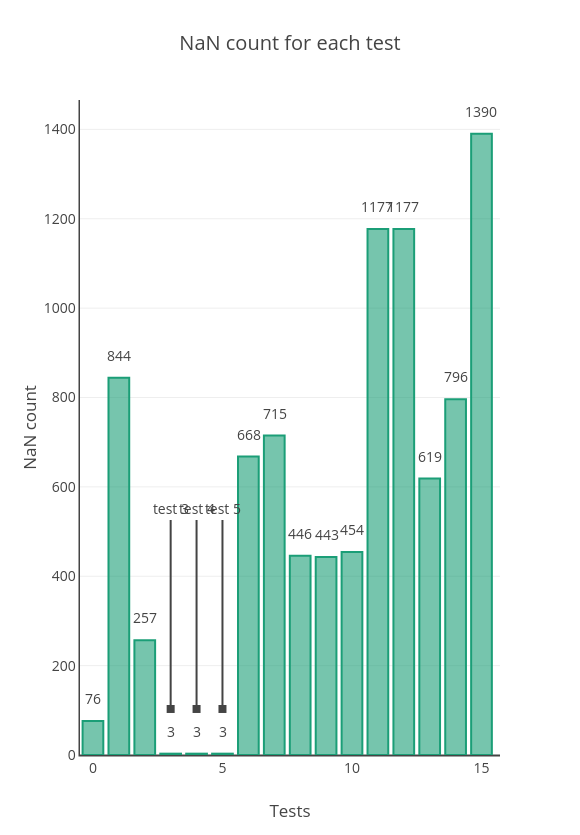

In [8]:
nan_count_bar = mvc.plot.count_nan(
    df_wide.iloc[:, df_wide.columns != 'muscle'],
    title='NaN count for each test',
    xtitle='Tests',
    ytitle='NaN count')
py.iplot(nan_count_bar, filename='mvc/nan_count_bar')

## 5.2. Display positions

In [9]:
IMAGES_PATH = Path('./data/positions_mvc.mat')
positions = sio.loadmat(IMAGES_PATH)['positions']

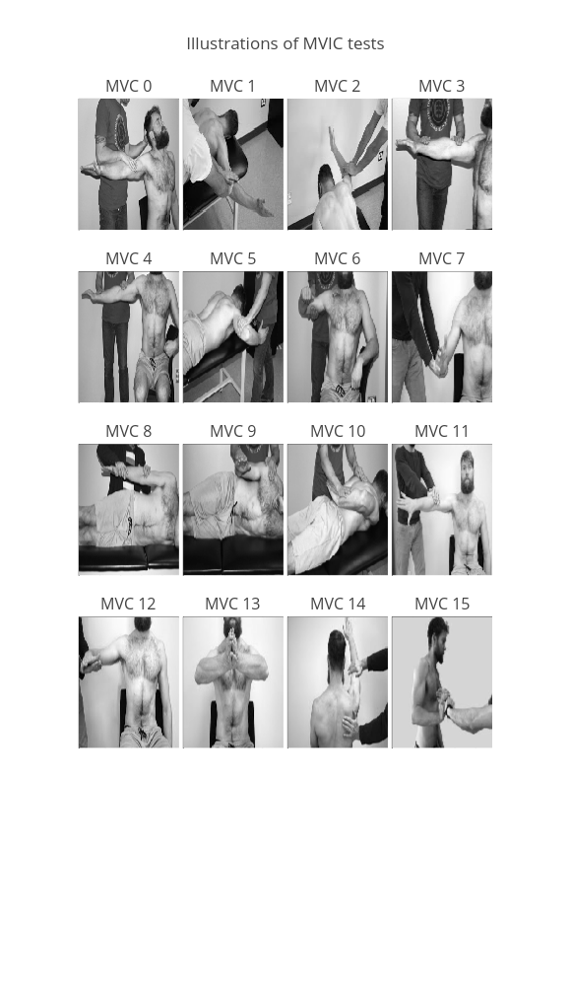

In [11]:
positions_all = mvc.plot.mvc_positions(
    positions, idx=conf['TESTS'], title='Illustrations of MVIC tests')

py.iplot(positions_all, filename='mvc/positions_all')